# Forecast Mario's farm

In [1]:
import datetime
import inspect
import os

# scientific python add-ons
import numpy as np
import pandas as pd

# plotting stuff
# first line makes the plots appear in the notebook
%matplotlib inline 
import matplotlib.pyplot as plt
import matplotlib as mpl

# finally, we import the pvlib library
import pvlib
from pvlib import solarposition, irradiance, atmosphere, pvsystem, inverter, temperature, iam
from pvlib.forecast import GFS, NAM, NDFD, RAP, HRRR

/Users/luisvargas/Desktop/Tesis Pvlib/env_pvlib_tesis/lib/python3.8/site-packages/pvlib/forecast.py:18: UserWarning: The forecast module algorithms and features are highly experimental. The API may change, the functionality may be consolidated into an io module, or the module may be separated into its own package.
  warnings.warn(


In [2]:
# Choose a location.
# Cutonalá
latitude = 20.56
longitude = -103.22 
tz = 'America/Mexico_City'

In [3]:
surface_tilt = 30
surface_azimuth = 180 # pvlib uses 0=North, 90=East, 180=South, 270=West convention
albedo = 0.2

In [4]:
#Variables de tiempo
start = pd.Timestamp(datetime.date.today(), tz=tz) # today's date
end = start + pd.Timedelta(days=7) # 7 days from today

In [5]:
# Se define el modelo de pronostico
fm = GFS()
#fm = NAM()
#fm = NDFD()
#fm = RAP()
#fm = HRRR()

In [6]:
# Se obtiene la data y se procesa del modelo meteorologico
forecast_data = fm.get_processed_data(latitude, longitude, start, end)

In [7]:
#Global Horizontal Irradiance
ghi = forecast_data['ghi']
#ghi.plot()
#plt.ylabel('Irradiance ($W/m^{-2}$)');

In [8]:
temp_air = forecast_data['temp_air']

In [9]:
# retrieve time and location parameters
time = forecast_data.index
a_point = fm.location

In [10]:
#Posición solar en el tiempo
solpos = a_point.get_solarposition(time)
#solpos.plot()

In [11]:
dni_extra = irradiance.get_extra_radiation(fm.time)
#dni_extra.plot()
#plt.ylabel('Extra terrestrial radiation ($W/m^{-2}$)')

In [12]:
airmass = atmosphere.get_relative_airmass(solpos['apparent_zenith'])
#airmass.plot()
#plt.ylabel('Airmass')

In [13]:
poa_sky_diffuse = irradiance.haydavies(surface_tilt, surface_azimuth,
                                       forecast_data['dhi'], forecast_data['dni'], dni_extra,
                                       solpos['apparent_zenith'], solpos['azimuth'])
#poa_sky_diffuse.plot()
#plt.ylabel('Irradiance ($W/m^{-2}$)')

In [14]:
poa_ground_diffuse = irradiance.get_ground_diffuse(surface_tilt, ghi, albedo=albedo)
#poa_ground_diffuse.plot()
#plt.ylabel('Irradiance ($W/m^{-2}$)')

In [15]:
aoi = irradiance.aoi(surface_tilt, surface_azimuth, solpos['apparent_zenith'], solpos['azimuth'])
#aoi.plot()
#plt.ylabel('Angle of incidence (deg)')

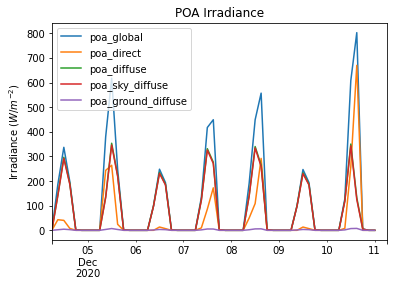

In [18]:
poa_irrad = irradiance.poa_components(aoi, forecast_data['dni'], poa_sky_diffuse, poa_ground_diffuse)
poa_irrad.plot()
plt.ylabel('Irradiance ($W/m^{-2}$)')
plt.title('POA Irradiance');

In [19]:
poa_irrad

,poa_global,poa_direct,poa_diffuse,poa_sky_diffuse,poa_ground_diffuse
2020-12-04 06:00:00-06:00,0.000000,-0.000000,0.000000,0.000000,0.000000
2020-12-04 09:00:00-06:00,186.582931,43.076379,143.506552,141.202189,2.304363
2020-12-04 12:00:00-06:00,337.041717,40.362950,296.678767,292.133107,4.545660
2020-12-04 15:00:00-06:00,197.557772,7.795104,189.762668,187.011961,2.750708
2020-12-04 18:00:00-06:00,1.671740,0.000000,1.671740,1.648075,0.023665
2020-12-04 21:00:00-06:00,0.000000,-0.000000,0.000000,0.000000,0.000000
2020-12-05 00:00:00-06:00,0.000000,-0.000000,0.000000,0.000000,0.000000
2020-12-05 03:00:00-06:00,0.000000,-0.000000,0.000000,0.000000,0.000000
2020-12-05 06:00:00-06:00,0.000000,-0.000000,0.000000,0.000000,0.000000
2020-12-05 09:00:00-06:00,380.062784,243.440169,136.622615,133.072805,3.549809


In [21]:
poa_direct = poa_irrad['poa_direct']
poa_diffuse = poa_irrad['poa_diffuse']
poa_global = poa_irrad['poa_global']

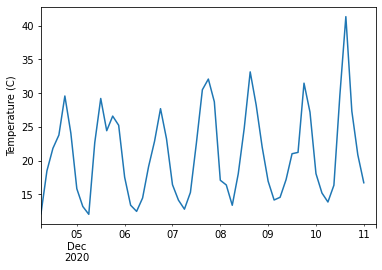

In [23]:
wind_speed = forecast_data['wind_speed']
thermal_params = temperature.TEMPERATURE_MODEL_PARAMETERS['sapm']['open_rack_glass_polymer']
pvtemp = temperature.sapm_cell(poa_irrad['poa_global'], temp_air, wind_speed, **thermal_params)
pvtemp.plot()
plt.ylabel('Temperature (C)');
#Calculo de la temperatura de la celda de acuerdo con el rendimiento del arreglo SANDIA
#See [1]_ for details on the Sandia Array Performance Model.
#pvtemp

### PV system

In [24]:
sandia_modules = pvsystem.retrieve_sam('SandiaMod')

In [26]:
pd.set_option('display.max_columns', None)
sandia_modules

,Advent_Solar_AS160___2006_,Advent_Solar_Ventura_210___2008_,Advent_Solar_Ventura_215___2009_,Aleo_S03_160__2007__E__,Aleo_S03_165__2007__E__,Aleo_S16_165__2007__E__,Aleo_S16_170__2007__E__,Aleo_S16_175__2007__E__,Aleo_S16_180__2007__E__,Aleo_S16_185__2007__E__,AstroPower_AP_100___2001_,AstroPower_AP_100__2000__E__,AstroPower_AP_110___2001_,AstroPower_AP_110__1999__E__,AstroPower_AP_120___2001_,AstroPower_AP_120__1999__E__,AstroPower_AP_1206___1998_,AstroPower_AP_130___2001_,AstroPower_AP_130__2002__E__,AstroPower_AP_50___2001_,AstroPower_AP_50__2000__E__,AstroPower_AP_65__1999__E__,AstroPower_AP_75___2001_,AstroPower_AP_75___2003_,AstroPower_AP_75__2003__E__,AstroPower_AP_8225___1997_,AstroPower_APX_110_SL___2002_,AstroPower_APX_110_SL__2002__E__,AstroPower_APX_120___2001_,AstroPower_APX_120__2002__E__,AstroPower_APX_130___2001_,AstroPower_APX_130__2002__E__,AstroPower_APX_140__2002__E__,AstroPower_APX_40__2002__E__,AstroPower_APX_45___2001_,AstroPower_APX_45__1999__E__,AstroPower_APX_45__2002__E__,AstroPower_APX_50__2002__E__,AstroPower_APX_65___2001_,AstroPower_APX_65__2002__E__,AstroPower_APX_75__2002__E__,AstroPower_APX_75_SC__2002__E__,AstroPower_APX_90__1999__E__,BP_Solar_BP2140S__2000__E__,BP_Solar_BP2150S__2000__E__,BP_Solar_BP270__2000__E__,BP_Solar_BP275__2000__E__,BP_Solar_BP3110__2006__E__,BP_Solar_BP3115__2006__E__,BP_Solar_BP3120__2006__E__,BP_Solar_BP3125__2003__E__,BP_Solar_BP3125__2006__E__,BP_Solar_BP3135__2006__E__,BP_Solar_BP3150__2003__E__,BP_Solar_BP3160__2003__E__,BP_Solar_BP3180N___2010_,BP_Solar_BP3220N_Module___2010_,BP_Solar_BP3232G___2010_,BP_Solar_BP340__2004__E__,BP_Solar_BP350__2004__E__,BP_Solar_BP365__2004__E__,BP_Solar_BP365TS__2007__E__,BP_Solar_BP380___2004_,BP_Solar_BP380__2003__E__,BP_Solar_BP380__2006__E__,BP_Solar_BP380J_Module___2009_,BP_Solar_BP380J_Module__2009__E__,BP_Solar_BP4150__2003__E__,BP_Solar_BP4160__2003__E__,BP_Solar_BP4170__2003__E__,BP_Solar_BP4175__2004__E__,BP_Solar_BP485__2004__E__,BP_Solar_BP5130__2000__E__,BP_Solar_BP580__2000__E__,BP_Solar_BP580__2002__E__,BP_Solar_BP585___2001_,BP_Solar_BP585__2000__E__,BP_Solar_BP585__2002__E__,BP_Solar_BP980__2001__E__,BP_Solar_BP990__2001__E__,BP_Solar_MSX110__2003__E__,BP_Solar_MSX120__2003__E__,BP_Solar_MSX60__2003__E__,BP_Solar_MSX64__2003__E__,BP_Solar_SX110__2003__E__,BP_Solar_SX110S__2003__E__,BP_Solar_SX120__2003__E__,BP_Solar_SX120S__2003__E__,BP_Solar_SX140__2003__E__,BP_Solar_SX150__2003__E__,BP_Solar_SX160__2003__E__,BP_Solar_SX160B__2005__E__,BP_Solar_SX170B__2005__E__,BP_Solar_SX305__2007__E__,BP_Solar_SX310__2007__E__,BP_Solar_SX3130__2007__E__,BP_Solar_SX3140__2007__E__,BP_Solar_SX3150__2003__E__,BP_Solar_SX3160__2003__E__,BP_Solar_SX3190__2007__E__,BP_Solar_SX3195__2007__E__,BP_Solar_SX320__2007__E__,BP_Solar_SX3200__2007__E__,BP_Solar_SX330__2007__E__,BP_Solar_SX340__2007__E__,BP_Solar_SX350__2007__E__,BP_Solar_SX365__2007__E__,BP_Solar_SX375__2003__E__,BP_Solar_SX380__2003__E__,BP_Solar_SX55__2003__E__,BP_Solar_SX60__2003__E__,BP_Solar_SX70__2003__E__,BP_Solar_SX75__2003__E__,Canadian_Solar_CS5P_220M___2009_,Entech_22X_Concentrator___1994_,EPV_40___1998_,Evergreen_ES_180__2008__E__,Evergreen_ES_180_RL_T_Module___2008_,Evergreen_ES_180_RL_T_Module__2008__E__,Evergreen_ES_190__2008__E__,Evergreen_ES_195__2008__E__,First_Solar_FS_265__2007__E__,First_Solar_FS_267__2007__E__,First_Solar_FS_270__2007__E__,First_Solar_FS_272___2009_,First_Solar_FS_272__2007__E__,First_Solar_FS_275__2007__E__,First_Solar_FS_45___2003_,First_Solar_FS_45__2003__E__,First_Solar_FS_50___2000_,First_Solar_FS_50__2001__E__,First_Solar_FS_50__2004__E__,First_Solar_FS_55__2003__E__,First_Solar_FS_55__2004__E__,Kyocera_Solar_KC120_1___1998_,Kyocera_Solar_KC120_1__1999__E__,Kyocera_Solar_KC125G__2003__E__,Kyocera_Solar_KC130TM__2008__E__,Kyocera_Solar_KC150___2002_,Kyocera_Solar_KC150__2002__E__,Kyocera_Solar_KC158G__2003__E__,Kyocera_Solar_KC167G__2003__E__,Kyocera_Solar_KC35__2003__E__,Kyocera_Solar_KC40__2003__E__,Kyocera_Solar_KC40T__2008_

In [27]:
cec_modules = pvsystem.retrieve_sam('cecmod')
cec_modules

,A10Green_Technology_A10J_S72_175,A10Green_Technology_A10J_S72_180,A10Green_Technology_A10J_S72_185,A10Green_Technology_A10J_M60_220,A10Green_Technology_A10J_M60_225,A10Green_Technology_A10J_M60_230,A10Green_Technology_A10J_M60_235,A10Green_Technology_A10J_M60_240,A2Peak_Power_POWER_ON_P220_6x10,Aavid_Solar_ASMS_165P,Aavid_Solar_ASMS_180M,Aavid_Solar_ASMS_185M,Aavid_Solar_ASMS_220P,Aavid_Solar_ASMS_225M,Aavid_Solar_ASMS_230M,Aavid_Solar_ASMS_235M,Aavid_Solar_ASMS_270P,Aavid_Thermalloy_ASMP_175M,Aavid_Thermalloy_ASMP_180M,Ablytek_5MN6C175_A0,Ablytek_5MN6C180_A0,Ablytek_5MN6C185_A0,Ablytek_6PN6A220_A0,Ablytek_6PN6A225_A0,Ablytek_6PN6A230_A0,Ablytek_6PN6A235_A0,Ablytek_6PN6A240_A0,Ablytek_6MN6A270,Ablytek_6MN6A275,Ablytek_6MN6A280,Ablytek_6MN6A285,Ablytek_6MN6A290,AccuSolar_Power_ASP610_B230,Advance_Power_API_P210,Advance_Power_API_P215,Advance_Power_API_P220,Advance_Power_API_M225,Advance_Power_API_P225,Advance_Power_API_M230,Advance_Power_API_P230,Advance_Power_API_M235,Advance_Power_API_P235,Advance_Power_API_M240,Advance_Power_API_P240,Advance_Power_API_M245,Advance_Power_API_P245,Advance_Power_API_M250,Advance_Power_API_P250,Advance_Power_API_M255,Advance_Power_API_P255,Advance_Power_API_M260,Advance_Power_API_P260,Advance_Power_API_M265,Advance_Power_API_P265,Advance_Power_API_M270,Advance_Power_API_P270,Advance_Power_API_M275,Advance_Power_API_P275,Advance_Power_API_M280,Advance_Power_API_P280,Advance_Power_API_M285,Advance_Power_API_P285,Advance_Power_API_M290,Advance_Power_API_P290,Advance_Power_API_M295,Advance_Power_API_P295,Advance_Power_API_M300,Advance_Power_API_P300,Advance_Power_API_M305,Advance_Power_API_P305,Advance_Power_API_M310,Advance_Power_API_P310,Advance_Power_API_M315,Advance_Power_API_P315,Advance_Power_API_P320,Advance_Power_API_P325,Advance_Power_API_M330,Advance_Power_API_P330,Advance_Power_API_M335,Advance_Power_API_P335,Advance_Power_API_M340,Advance_Power_API_M345,Advance_Power_API_M350,Advance_Power_API_M355,Advance_Power_API_M360,Advance_Power_API_M365,Advance_Power_API_M370,Advance_Solar_Hydro_Wind_Power_API_150,Advance_Solar_Hydro_Wind_Power_API_160,Advance_Solar_Hydro_Wind_Power_API_165,Advance_Solar_Hydro_Wind_Power_API_170,Advance_Solar_Hydro_Wind_Power_API_175,Advance_Solar_Hydro_Wind_Power_API_180,Advance_Solar_Hydro_Wind_Power_API156P_200,Advance_Solar_Hydro_Wind_Power_API156P_210,Advance_Solar_Hydro_Wind_Power_API156P_220,Advance_Solar_Hydro_Wind_Power_API156P_230,Advanced_Renewable_Energy_AREi_210W_M6_G,Advanced_Renewable_Energy_AREi_215W_M6_G,Advanced_Renewable_Energy_AREi_220W_M6_G,Advanced_Renewable_Energy_AREi_225W_M6_G,Advanced_Renewable_Energy_AREi_230W_M6_G,Advanced_Solar_Power__Hangzhou__ASP_S1_80,Aleo_Solar_P18y250,Aleo_Solar_S18y250,Aleo_Solar_P18y255,Aleo_Solar_S18y255,Aleo_Solar_P18y260,Aleo_Solar_S18y260,Aleo_Solar_P18Y265,Aleo_Solar_S18y265,Aleo_Solar_S19Y270,Aleo_Solar_S79y270,Aleo_Solar_P19Y275,Aleo_Solar_S19y275,Aleo_Solar_S79y275,Aleo_Solar_S19y280,Aleo_Solar_S59y280,Aleo_Solar_S79y280,Aleo_Solar_P19Y285,Aleo_Solar_S19y285,Aleo_Solar_S59y285,Aleo_Solar_S79y285,Aleo_Solar_P19Y290,Aleo_Solar_S19y290,Aleo_Solar_S59y290,Aleo_Solar_S79Y290,Aleo_Solar_P19Y295,Aleo_Solar_S19Y295,Aleo_Solar_S59Y295,Aleo_Solar_S79Y295,Aleo_Solar_P19Y300,Aleo_Solar_S19Y300,Aleo_Solar_S59Y300,Aleo_Solar_S79Y300,Aleo_Solar_P19Y305,Aleo_Solar_S19Y305,Aleo_Solar_S59Y305,Aleo_Solar_S79Y305,Aleo_Solar_P19Y310,Aleo_Solar_S19Y310,Aleo_Solar_S59Y310,alfasolar_alfasolar_P6L60_220,alfasolar_alfasolar_P6L60_225,alfasolar_alfasolar_P6L60_230,alfasolar_alfasolar_P6L60_235,alfasolar_alfasolar_M6L60_240,alfasolar_alfasolar_P6L60_240,alfasolar_alfasolar_M6L60_245,alfasolar_alfasolar_P6L60_245,alfasolar_alfasolar_M6L60_250,alfasolar_alfasolar_P6L60_250,alfasolar_alfasolar_M6L60_255,alfasolar_alfasolar_M6L60_260,alfasolar_alfasolar_M6L60_265,Alps_Technology_ATI_S572_175,Alps_Technology_ATI_S572_180,Alps_Technology_ATI_S572_185,Alps_Technology_ATI_M660_220,Alps_Technology_ATI_M660_225,Alps_Technology_ATI_M660_230,